## Advanced Lane Finding Project

Steps of this project are the following:

1 **Camera Calibration**
    -- Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
    
2 **Distortion Correction**
    -- Apply a distortion correction to raw images.

3 **Lane Lines Image Processing**
    -- Use color transforms, gradients, etc., to create a thresholded binary image.
    
4 **Bird-Eye's View Transform of Lane Images**
    -- Apply perspective transform to rectify binary image ("birds-eye view").
    
5 **Algorithmically Extract Lane Lines**
    -- Detect lane pixels and fit to find the lane boundary.
    
6 **Estimate Lane Cuvature and Vehicle Posiiton**
    -- Determine the curvature of the lane and vehicle position with respect to center.
    
7 **Warp estimates back to original view**
    -- Warp the detected lane boundaries back onto the original image.
    
8 **Visually Overlay detected Lane**
    -- Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.
    


## 1. Camera Calibration

**Calibration occurs one time only in the entire pipeline**

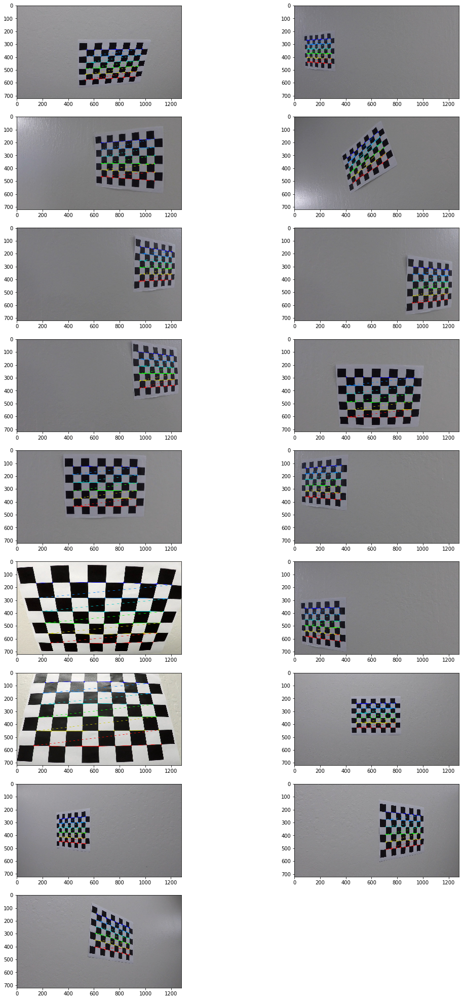

In [1]:
## camera calibration
import numpy as np
import cv2
import glob
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
%matplotlib inline
# prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
objp = np.zeros((6*9,3), np.float32)
objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)

# Arrays to store object points and image points from all the images.
objpoints = [] # 3d points in real world space
imgpoints = [] # 2d points in image plane.

# Make a list of calibration images
images = glob.glob('../camera_cal/calibration*.jpg')

# Step through the list and search for chessboard corners
plt.figure(figsize=(18, 80))
i=1
for fname in images:
    img = mpimg.imread(fname)
    gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)

    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

    # If found, add object points, image points
    if ret == True:
        objpoints.append(objp)
        imgpoints.append(corners)

        # Draw and display the corners
        img = cv2.drawChessboardCorners(img, (9,6), corners, ret)
        sign  = plt.subplot(len(images), 2, i)
        i+=1
        plt.imshow(img)
        

## 2. Distortion Correction 

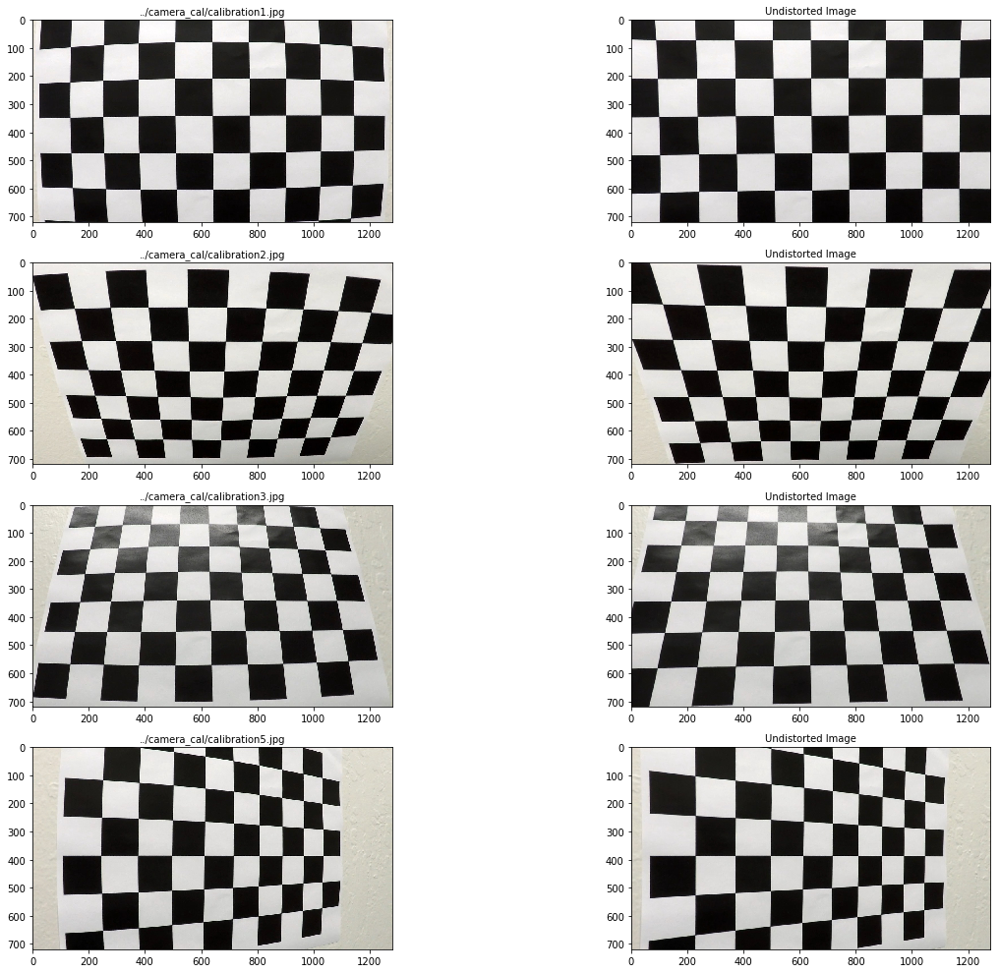

In [2]:
import pickle
%matplotlib inline

# Test undistortion on an image
img = mpimg.imread('../camera_cal/calibration11.jpg')
img_size = (img.shape[1], img.shape[0])

# Do camera calibration given object points and image points
ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, img_size,None,None)


dst = cv2.undistort(img, mtx, dist, None, mtx)
#cv2.imwrite('../camera_cal/test_undist.jpg',dst)

# Save the camera calibration result for later use (we won't worry about rvecs / tvecs)
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "../camera_cal/dist_pickle.p", "wb" ) )

# undistort all calibration images
plt.figure(figsize=(20, 90))
i=0
samplenames = ['../camera_cal/calibration1.jpg','../camera_cal/calibration2.jpg',
               '../camera_cal/calibration3.jpg','../camera_cal/calibration5.jpg']
for fname in samplenames:
    img = mpimg.imread(fname)
    dst = cv2.undistort(img, mtx, dist, None, mtx)
    orig= plt.subplot(len(images), 2, (i*2)+1)
    orig.set_title(fname, fontsize=10)
    plt.imshow(img)
    undist= plt.subplot(len(images), 2, (i*2)+2)
    undist.set_title('Undistorted Image', fontsize=10)
    plt.imshow(dst)
    i+=1

        

## 3. Lane Lines Image Processing

**Process images to enhance lane lines **

In [3]:
#
# Image processsing functions
#
import numpy as np
import cv2
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
# Visualizations will be shown in the notebook.
%matplotlib inline


def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0,255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    binary_output = np.zeros_like(scaled_sobel)
    # Here I'm using inclusive (>=, <=) thresholds, but exclusive is ok too
    binary_output[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    # Return the result
    return scaled_sobel, binary_output

def mag_thresh(img, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    binary_output = np.zeros_like(gradmag)
    binary_output[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    # Return the binary image
    return binary_output


def dir_threshold(img, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    binary_output =  np.zeros_like(absgraddir)
    binary_output[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1

    # Return the binary image
    return binary_output
def filterHorizontalLines(image, kernel_size = 5,iterations=1):
    linek = np.zeros((kernel_size, kernel_size),dtype=np.uint8)
    linek[int(kernel_size/2),...]=1
   
    x=cv2.morphologyEx(image, cv2.MORPH_OPEN, linek ,iterations)
    return image-x

def hls_select(img, thresh=(0, 255), channel = 's'):
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    if (channel == 'h'):
        out_channel = hls[:,:,0]
    elif (channel == 'l'):
        out_channel = hls[:,:,1]
    else:
        out_channel = hls[:,:,2]
        
    binary_output = np.zeros_like(out_channel)
    binary_output[(out_channel > thresh[0]) & (out_channel <= thresh[1])] = 1
    return out_channel, binary_output


def hsv_select(img, thresh=(0, 255), channel='s'):
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HSV)
    
    if (channel == 'h'):
        out_channel = hsv[:,:,0]
    elif (channel == 'l'):
        out_channel = hsv[:,:,1]
    else:
        out_channel = hsv[:,:,2]
        
    scale_factor = np.max(out_channel)/255 
    out_channel = (out_channel/scale_factor).astype(np.uint8) 

    return out_channel

def colorfilter(image):
    lower_white = np.array([190,190,190])
    upper_white = np.array([255,255,255])

    white_filter = cv2.inRange(image, lower_white, upper_white)
    
    lower_yellow = np.array([145,145,0])
    upper_yellow = np.array([255,255,125])
    yellow_filter = cv2.inRange(image, lower_yellow, upper_yellow)
    
    lower_black = np.array([50, 50, 50])
    upper_black = np.array([100, 100, 100])

    black_filter = cv2.inRange(image, lower_black, upper_black)

    return white_filter, yellow_filter, black_filter


In [4]:
#
# Folders
#
dirname1 = "F:/EDX Courses/Enrolled/Self Driving Nanodegree Udacity/CarND-Advanced-Lane-Lines/Frames/challenge_video/"
dirname2 = "F:/EDX Courses/Enrolled/Self Driving Nanodegree Udacity/CarND-Advanced-Lane-Lines/Frames/project_video/"
dirname3 = "F:/EDX Courses/Enrolled/Self Driving Nanodegree Udacity/CarND-Advanced-Lane-Lines/Frames/harder_challenge_video/"
dirname4 = "F:/EDX Courses/Enrolled/Self Driving Nanodegree Udacity/CarND-Advanced-Lane-Lines/test_images/"
dirname = dirname2
dirname5 = "F:/EDX Courses/Enrolled/Self Driving Nanodegree Udacity/CarND-Advanced-Lane-Lines/"

['project_video 01.jpg', 'project_video 02.jpg', 'project_video 03.jpg', 'project_video 04.jpg', 'project_video 05.jpg', 'project_video 06.jpg', 'project_video 07.jpg', 'project_video 08.jpg', 'project_video 09.jpg', 'project_video 10.jpg', 'project_video 11.jpg', 'project_video 12.jpg', 'project_video 13.jpg', 'project_video 14.jpg', 'project_video 15.jpg', 'project_video 16.jpg', 'project_video 17.jpg', 'project_video 18.jpg', 'project_video 19.jpg', 'project_video 20.jpg', 'project_video 21.jpg', 'project_video 22.jpg', 'project_video 23.jpg', 'project_video 24.jpg', 'project_video 25.jpg', 'project_video 26.jpg', 'project_video 27.jpg', 'project_video 28.jpg', 'project_video 29.jpg', 'project_video 30.jpg', 'project_video 31.jpg', 'project_video 32.jpg', 'project_video 33.jpg', 'project_video 34.jpg', 'project_video 35.jpg', 'project_video 36.jpg', 'project_video 37.jpg', 'project_video 38.jpg', 'project_video 39.jpg', 'project_video 40.jpg', 'project_video 41.jpg', 'project_video 

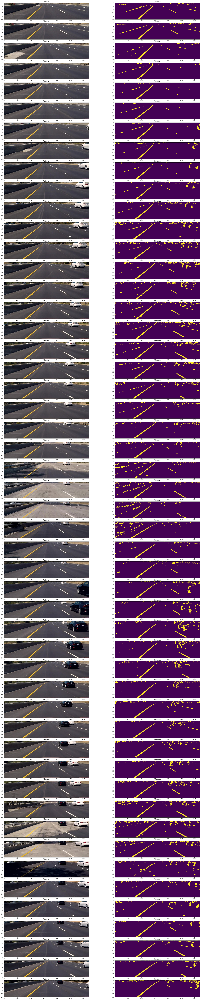

In [5]:
#
# Image Lane Lines Extraction Study
#
import os
file_list = os.listdir(dirname)
print(file_list)
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

%matplotlib inline
ksize = 5
Sksize = 11
    
images = []
for i in range(0,len(file_list)):
    images.append(mpimg.imread(dirname+file_list[i]))
    

plt.figure(figsize=(30, 150))
columns = 2
height = images[0].shape[0] 
width  = images[0].shape[1] 
top_mask = height//2
bottom_mask = 50
images2 = np.array(images) 
del images
images2 = images2[:,top_mask+60:height-bottom_mask, :, :]
for i, image in enumerate(images2):
    # Original
    c1  = plt.subplot((len(images2)), columns, columns*i + 1)
    c1.set_title("Original")    
    plt.imshow(image)    

    # Sobel X
    lowthresh = 0
    highthresh = 255
    sobel, cleansblbin = abs_sobel_thresh(image, orient='x', sobel_kernel=ksize,thresh=(18, 126))
    
    # S-Channel
    s_channel, cleansbin = hls_select(image, thresh=(90, 255), channel = 's')
    cleansbin = filterHorizontalLines(cleansbin, kernel_size = 35, iterations = 1)    

    # Colorextraction
    white, yellow, black = colorfilter(image)

    # Combine s-channel and sobel-x with smoothing and H=Filter
    combined = cleansbin | cleansblbin 
    smoothcomb = cv2.bilateralFilter(combined,9,75,75) 
    cleancomb = filterHorizontalLines(smoothcomb, kernel_size = 35, iterations = 1)    
    
    # Add smoothed Yellow color 
    smoothyellow = cv2.bilateralFilter(yellow,9,75,75) 
    nextcombined = np.zeros(image.shape[:2])
    nextcombined[((cleancomb == 1) | (smoothyellow == 1))] = 1

    c1  = plt.subplot((len(images2)), columns, columns*i + 2)
    c1.set_title("Combined")
    plt.imshow(nextcombined)

    

In [6]:
def crop_image(image):
    height = image.shape[0] 
    width  = image.shape[1] 
    top_mask = height//2
    bottom_mask = 50
    return image[top_mask+60:height-bottom_mask, :, :], [top_mask, bottom_mask]
# full image thresholding  and undistort
def image_thresh(image, mtx, dist):
    # Use the OpenCV undistort() function to remove distortion
    undist_image = cv2.undistort(image, mtx, dist, None, mtx)
    
    sobel, sobelbin = abs_sobel_thresh(undist_image, orient='x', sobel_kernel=5,thresh=(18, 126))
    
    # S-Channel
    s_channel, schxbin = hls_select(undist_image, thresh=(90, 255), channel = 's')
    schxbin = filterHorizontalLines(schxbin, kernel_size = 35, iterations = 1)    

    # Colorextraction
    white, yellow, black = colorfilter(undist_image)

    # Combine s-channel and sobel-x with smoothing and H-Filter
    smoothcomb = cv2.bilateralFilter(schxbin | sobelbin,9,75,75) 
    cleancomb = filterHorizontalLines(smoothcomb, kernel_size = 35, iterations = 1)    
    
    # Add smoothed Yellow color 
    smoothyellow = cv2.bilateralFilter(yellow,9,75,75) 
    processsed_image = np.zeros(undist_image.shape[:2])
    processsed_image[((cleancomb == 1) | (smoothyellow == 1))] = 1
    
    return processsed_image, undist_image

## 4. Bird-Eye's View Transform of Lane Images

** Apply perspective transform to rectify binary image ("birds-eye view") **

In [7]:
# Define a function that takes an image, number of x and y points, 
# camera matrix and distortion coefficients
def unwarp(pimg, src, dst):

    # Grab the image shape
    pimg_size = (pimg.shape[1], pimg.shape[0])

    # Given src and dst points, calculate the perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Warp the image using OpenCV warpPerspective()
    warped = cv2.warpPerspective(pimg, M, pimg_size)

    # Return the resulting image and matrix
    return warped, M, Minv

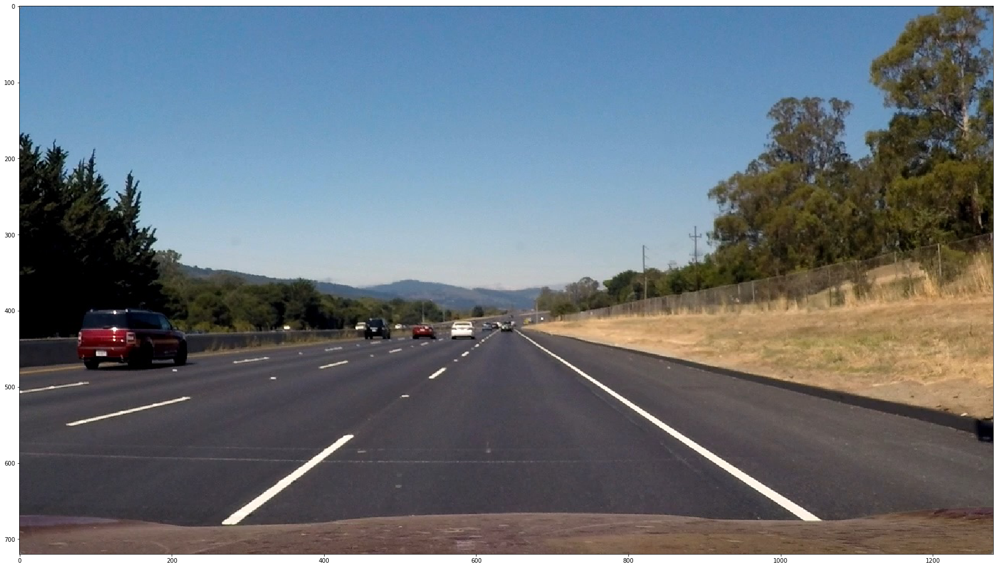

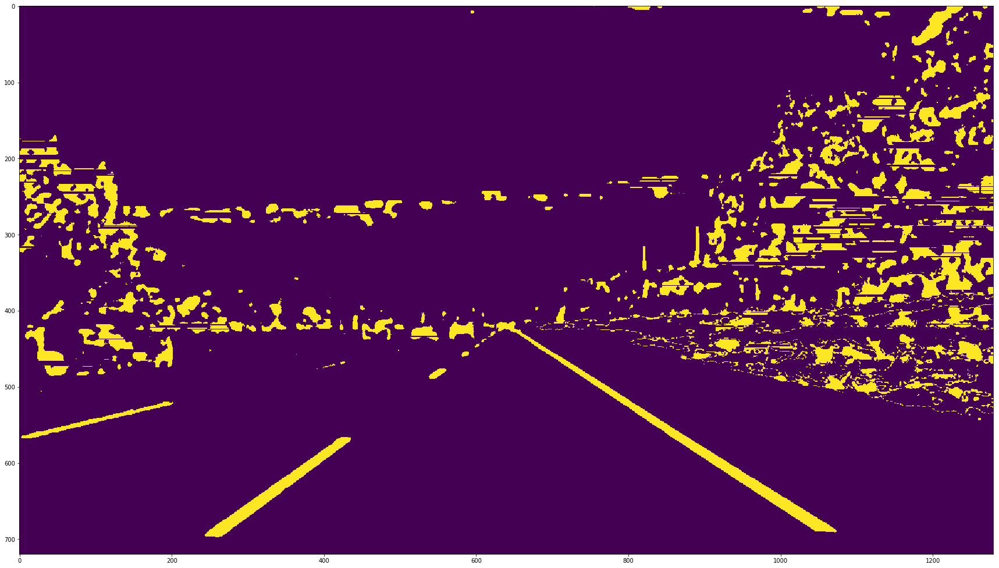

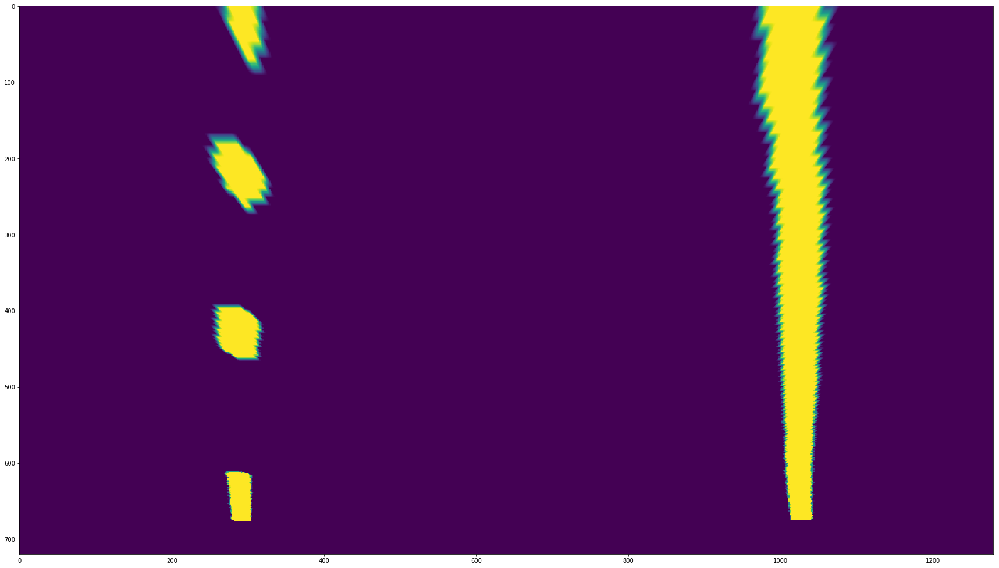

In [8]:
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
image = mpimg.imread(dirname4+"straight_lines2.jpg")

plt.figure(figsize=(30, 30))
#cimage, mask = crop_image(image)
plt.imshow(image) 
pimage, undist_image = image_thresh(image, mtx, dist)
plt.figure(figsize=(30, 30))
plt.imshow(pimage) 


# For source points I'm grabbing the outer four detected corners
src = np.float32([[290,668], [525,500], [755,500], [990,668]])
# For destination points, I'm arbitrarily choosing some points to be
# a nice fit for displaying our warped result 
# again, not exact, but close enough for our purposes
dst = np.float32([[290, 668], [290,500], [990, 500],[990, 668]])

wraped_pimage, pM, pMinv = unwarp(pimage, src, dst)
plt.figure(figsize=(30, 30))
plt.imshow(wraped_pimage) 


['project_video 01.jpg', 'project_video 02.jpg', 'project_video 03.jpg', 'project_video 04.jpg', 'project_video 05.jpg', 'project_video 06.jpg', 'project_video 07.jpg', 'project_video 08.jpg', 'project_video 09.jpg', 'project_video 10.jpg', 'project_video 11.jpg', 'project_video 12.jpg', 'project_video 13.jpg', 'project_video 14.jpg', 'project_video 15.jpg', 'project_video 16.jpg', 'project_video 17.jpg', 'project_video 18.jpg', 'project_video 19.jpg', 'project_video 20.jpg', 'project_video 21.jpg', 'project_video 22.jpg', 'project_video 23.jpg', 'project_video 24.jpg', 'project_video 25.jpg', 'project_video 26.jpg', 'project_video 27.jpg', 'project_video 28.jpg', 'project_video 29.jpg', 'project_video 30.jpg', 'project_video 31.jpg', 'project_video 32.jpg', 'project_video 33.jpg', 'project_video 34.jpg', 'project_video 35.jpg', 'project_video 36.jpg', 'project_video 37.jpg', 'project_video 38.jpg', 'project_video 39.jpg', 'project_video 40.jpg', 'project_video 41.jpg', 'project_video 

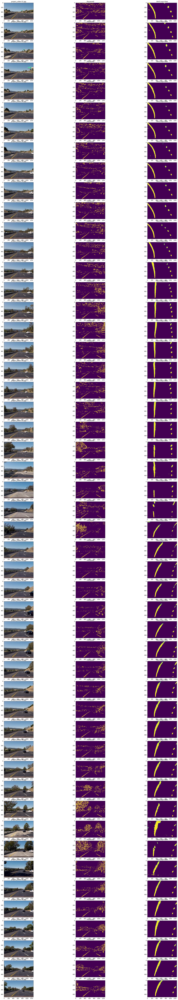

In [9]:
#
#  Bird's eye study
#
import os
import re
file_list = sorted(os.listdir(dirname), key=lambda x: (int(re.sub('\D','',x)),x))
print(file_list)
import matplotlib.image as mpimg
import matplotlib.pyplot as plt

%matplotlib inline
ksize = 5
Sksize = 11

# For source points I'm grabbing the outer four detected corners
src = np.float32([[290,668], [525,500], [755,500], [990,668]])
# For destination points, I'm arbitrarily choosing some points to be
# a nice fit for displaying our warped result 
# again, not exact, but close enough for our purposes
dst = np.float32([[290, 668], [290,500], [990, 500],[990, 668]])

images = []
for i in range(0,len(file_list)):
    images.append(mpimg.imread(dirname+file_list[i]))
    

plt.figure(figsize=(30, 150))
columns = 3
height = images[0].shape[0] 
width  = images[0].shape[1] 
top_mask = height//2
bottom_mask = 50
images2 = np.array(images) 
del images
#images2 = images2[:,top_mask+60:height-bottom_mask, :, :]
warped = []
M = []
Minv = []
undist = []
for i, image in enumerate(images2):
    # Original
    c1  = plt.subplot((len(images2)), columns, columns*i + 1)
    c1.set_title(file_list[i])    
    plt.imshow(image)    

    c1  = plt.subplot((len(images2)), columns, columns*i + 2)
    c1.set_title("Processed")
    pimage, undist_image = image_thresh(image, mtx, dist)
    plt.imshow(pimage)

    c1  = plt.subplot((len(images2)), columns, columns*i + 3)
    c1.set_title("Bird's eye View")
    warped_pimage, pM, pMinv = unwarp(pimage, src, dst)
    plt.imshow(warped_pimage)
    warped.append(warped_pimage)
    M.append(pM)
    Minv.append(pMinv)
    undist.append(undist_image)


## 5. Algorithmically Extract Lane Lines



**Detect lane pixels using convolution **

In [10]:
def window_mask(width, height, img_ref, center,level):
    output = np.zeros_like(img_ref)
    output[int(img_ref.shape[0]-(level+1)*height):int(img_ref.shape[0]-level*height),max(0,int(center-width/2)):min(int(center+width/2),img_ref.shape[1])] = 1
    return output

def find_window_centroids(image, window_width, window_height, margin):
    
    window_centroids = [] # Store the (left,right) window centroid positions per level
    window = np.ones(window_width) # Create our window template that we will use for convolutions
    
    # First find the two starting positions for the left and right lane by using np.sum to get the vertical image slice
    # and then np.convolve the vertical image slice with the window template 
    
    # Sum quarter bottom of image to get slice, could use a different ratio
    l_sum = np.sum(image[int(3*image.shape[0]/4):,:int(image.shape[1]/2)], axis=0)
    l_center = np.argmax(np.convolve(window,l_sum))-window_width/2
    r_sum = np.sum(image[int(3*image.shape[0]/4):,int(image.shape[1]/2):], axis=0)
    r_center = np.argmax(np.convolve(window,r_sum))-window_width/2+int(image.shape[1]/2)
    
    # Add what we found for the first layer
    window_centroids.append((l_center,r_center))
    
    # Go through each layer looking for max pixel locations
    for level in range(1,(int)(image.shape[0]/window_height)):
        # convolve the window into the vertical slice of the image
        image_layer = np.sum(image[int(image.shape[0]-(level+1)*window_height):int(image.shape[0]-level*window_height),:], axis=0)
        conv_signal = np.convolve(window, image_layer)
        # Find the best left centroid by using past left center as a reference
        # Use window_width/2 as offset because convolution signal reference is at right side of window, not center of window
        offset = window_width/2
        l_min_index = int(max(l_center+offset-margin,0))
        l_max_index = int(min(l_center+offset+margin,image.shape[1]))
        l_center = np.argmax(conv_signal[l_min_index:l_max_index])+l_min_index-offset
        # Find the best right centroid by using past right center as a reference
        r_min_index = int(max(r_center+offset-margin,0))
        r_max_index = int(min(r_center+offset+margin,image.shape[1]))
        r_center = np.argmax(conv_signal[r_min_index:r_max_index])+r_min_index-offset
        # Add what we found for that layer
        window_centroids.append((l_center,r_center))

    return window_centroids



In [11]:
# Load a thresholded image from previous study
warped = np.array(warped, np.uint8)
unidst = np.array(undist)
M = np.array(M)
Minv = np.array(Minv)
warped_image = warped[0]
undist_image = undist[0]
# window convolution settings
window_width = 50 
window_height = 80 # Break image into 9 vertical layers since image height is 720
margin = 50 # How much to slide left and right for searching



[(341.0, 1084.0), (341.0, 1084.0), (330.0, 1075.0), (312.0, 1025.0), (283.0, 1017.0), (244.0, 967.0), (197.0, 917.0), (147.0, 900.0), (97.0, 850.0)]


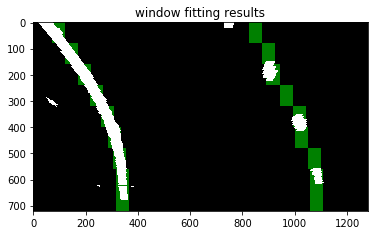

In [12]:
window_centroids = find_window_centroids(warped_image, window_width, window_height, margin)

# If we found any window centers
if len(window_centroids) > 0:

    # Points used to draw all the left and right windows
    l_points = np.zeros_like(warped_image)
    r_points = np.zeros_like(warped_image)

    # Go through each level and draw the windows 	
    for level in range(0,len(window_centroids)):
        # Window_mask is a function to draw window areas
        l_mask = window_mask(window_width,window_height,warped_image,window_centroids[level][0],level)
        r_mask = window_mask(window_width,window_height,warped_image,window_centroids[level][1],level)
        # Add graphic points from window mask here to total pixels found 
        l_points[(l_points == 255) | ((l_mask == 1) ) ] = 255
        r_points[(r_points == 255) | ((r_mask == 1) ) ] = 255

    # Draw the results
    template = np.array(r_points+l_points,np.uint8) # add both left and right window pixels together
    zero_channel = np.zeros_like(template) # create a zero color channel
    template = np.array(cv2.merge((zero_channel,template,zero_channel)),np.uint8) # make window pixels green
    warpage= np.dstack((warped_image, warped_image, warped_image))*255 # making the original road pixels 3 color channels
    output = cv2.addWeighted(warpage, 1, template, 0.5, 0.0) # overlay the orignal road image with window results
 
# If no window centers found, just display orginal road image
else:
    output = np.array(cv2.merge((warped_image,warped_image,warped_image)),np.uint8)
print(window_centroids)
# Display the final results
plt.imshow(output)
plt.title('window fitting results')
plt.show()

**Detect lane pixels using csliding windows and fit to find the lane boundary**

In [13]:
pic = 40

binary_warped = warped[pic]
# Take a histogram of the bottom half of the image
histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
# Create an output image to draw on and  visualize the result
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
# Find the peak of the left and right halves of the histogram
# These will be the starting point for the left and right lines
midpoint = np.int(histogram.shape[0]/2)
leftx_base = np.argmax(histogram[:midpoint])
rightx_base = np.argmax(histogram[midpoint:]) + midpoint

# Choose the number of sliding windows
nwindows = 9
# Set height of windows
window_height = np.int(binary_warped.shape[0]/nwindows)
# Identify the x and y positions of all nonzero pixels in the image
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
# Current positions to be updated for each window
leftx_current = leftx_base
rightx_current = rightx_base
# Set the width of the windows +/- margin
margin = 100
# Set minimum number of pixels found to recenter window
minpix = 50
# Create empty lists to receive left and right lane pixel indices
left_lane_inds = []
right_lane_inds = []

# Step through the windows one by one
for window in range(nwindows):
    # Identify window boundaries in x and y (and right and left)
    win_y_low = binary_warped.shape[0] - (window+1)*window_height
    win_y_high = binary_warped.shape[0] - window*window_height
    win_xleft_low = leftx_current - margin
    win_xleft_high = leftx_current + margin
    win_xright_low = rightx_current - margin
    win_xright_high = rightx_current + margin
    # Draw the windows on the visualization image
    cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),
    (0,255,0), 2) 
    cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),
    (0,255,0), 2) 
    # Identify the nonzero pixels in x and y within the window
    good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
    good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
    (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
    # Append these indices to the lists
    left_lane_inds.append(good_left_inds)
    right_lane_inds.append(good_right_inds)
    # If you found > minpix pixels, recenter next window on their mean position
    if len(good_left_inds) > minpix:
        leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
    if len(good_right_inds) > minpix:        
        rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

# Concatenate the arrays of indices
left_lane_inds = np.concatenate(left_lane_inds)
right_lane_inds = np.concatenate(right_lane_inds)

# Extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds] 

# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)

(720, 0)

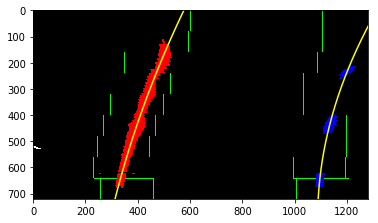

In [14]:
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
plt.imshow(out_img)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

In [15]:
next_pic = pic+1

In [16]:
binary_warped = warped[next_pic]
M_warped = M[next_pic]
Minv_warped = Minv[next_pic]
undist_image = undist[next_pic]
# from the next frame of video (also called "binary_warped")
# It's now much easier to find line pixels!
nonzero = binary_warped.nonzero()
nonzeroy = np.array(nonzero[0])
nonzerox = np.array(nonzero[1])
margin = 100
left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
left_fit[1]*nonzeroy + left_fit[2] + margin))) 

right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
right_fit[1]*nonzeroy + right_fit[2] + margin)))  

# Again, extract left and right line pixel positions
leftx = nonzerox[left_lane_inds]
lefty = nonzeroy[left_lane_inds] 
rightx = nonzerox[right_lane_inds]
righty = nonzeroy[right_lane_inds]
# Fit a second order polynomial to each
left_fit = np.polyfit(lefty, leftx, 2)
right_fit = np.polyfit(righty, rightx, 2)
# Generate x and y values for plotting
ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

(720, 0)

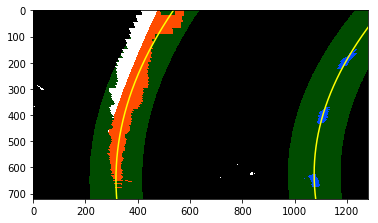

In [17]:
# Create an image to draw on and an image to show the selection window
out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
window_img = np.zeros_like(out_img)
# Color in left and right line pixels
out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

# Generate a polygon to illustrate the search window area
# And recast the x and y points into usable format for cv2.fillPoly()
left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
left_line_pts = np.hstack((left_line_window1, left_line_window2))
right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
right_line_pts = np.hstack((right_line_window1, right_line_window2))

# Draw the lane onto the warped blank image
cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

 ## 6. Estimate Lane Curvature and Vehicle Position
**Determine the curvature of the lane and vehicle position with respect to center.**

In [20]:
# Define conversions in x and y from pixels space to meters
# center offset in m: (leftx-270)*xm_per_pix
def curvature(leftx, lefty, rightx, righty):
    ym_per_pix = 47.4/680 # meters per pixel in y dimension
    xm_per_pix = 3.7/740 # meters per pixel in x dimension
    left_y_eval = np.max(lefty)
    right_y_eval = np.max(righty)
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(lefty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(righty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radius of curvature
    left_curverad = ((1 + (2*left_fit_cr[0]*left_y_eval*ym_per_pix + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*right_y_eval*ym_per_pix + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    pos = ((leftx[-1]+rightx[-1])/2-640)*xm_per_pix
    return left_curverad, right_curverad, pos

left_curverad , right_curverad, pos = curvature(leftx, lefty, rightx, righty)
# Now our radius of curvature is in meters
print(left_curverad, 'm', right_curverad, 'm', pos,  ' m')
# Example values: 632.1 m    626.2 m

923.45290719 m 741.09310174 m 0.365  m


 ## 7. Warp estimates back to original view
**Warp the detected lane boundaries back onto the original image**
## 8. Visually Overlay detected Lane 
**Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position **

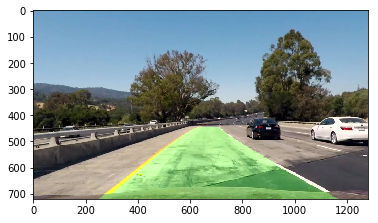

In [21]:
# Create an image to draw the lines on
warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

# Recast the x and y points into usable format for cv2.fillPoly()
pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
pts = np.hstack((pts_left, pts_right))

# Draw the lane onto the warped blank image
cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

# Warp the blank back to original image space using inverse perspective matrix (Minv)
newwarp = cv2.warpPerspective(color_warp, Minv_warped, (binary_warped.shape[1], binary_warped.shape[0])) 
# Combine the result with the original image
result = cv2.addWeighted(undist_image, 1, newwarp, 0.3, 0)
plt.imshow(result)

## 9. Full Pipeline
**Combine all step into a complete pipelione and run on the project video**

In [22]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = 0.0 
        #distance in meters of vehicle center from the line
        self.line_base_pos = 0.0 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        
# As it tuns out for this project's video, there is little need to smooth the detection of the lane lines between frames, 
# as the image thresholding combined with filters and pixel smooothing resulted in an almost 100% successful detaction rate 
# so no real frame to frame smoothing was required
# The data structure however is meant to be used for much more challenaging video frames. 
# Algorithms for smoothing frame to frame transitions weren't however focus of this project, 
# so the data structure is basically unused... 


In [23]:
def findlanelines(binary_warped):
    if (left_lane.detected==False or right_lane.detected==False):

        # Take a histogram of the bottom half of the image
        histogram = np.sum(binary_warped[binary_warped.shape[0]//2:,:], axis=0)
        # Find the peak of the left and right halves of the histogram
        # These will be the starting point for the left and right lines
        midpoint = np.int(histogram.shape[0]/2)
        leftx_base = np.argmax(histogram[:midpoint])
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint

        # Choose the number of sliding windows
        nwindows = 9
        # Set height of windows
        window_height = np.int(binary_warped.shape[0]/nwindows)
        # Identify the x and y positions of all nonzero pixels in the image
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        # Current positions to be updated for each window
        leftx_current = leftx_base
        rightx_current = rightx_base
        # Set the width of the windows +/- margin
        margin = 100
        # Set minimum number of pixels found to recenter window
        minpix = 50
        # Create empty lists to receive left and right lane pixel indices
        left_lane_inds = []
        right_lane_inds = []

        # Step through the windows one by one
        for window in range(nwindows):
            # Identify window boundaries in x and y (and right and left)
            win_y_low = binary_warped.shape[0] - (window+1)*window_height
            win_y_high = binary_warped.shape[0] - window*window_height
            win_xleft_low = leftx_current - margin
            win_xleft_high = leftx_current + margin
            win_xright_low = rightx_current - margin
            win_xright_high = rightx_current + margin
            # Identify the nonzero pixels in x and y within the window
            good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
            good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
            (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
            # Append these indices to the lists
            left_lane_inds.append(good_left_inds)
            right_lane_inds.append(good_right_inds)
            # If you found > minpix pixels, recenter next window on their mean position
            if len(good_left_inds) > minpix:
                leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
                left_lane.detected = True
            if len(good_right_inds) > minpix:        
                rightx_current = np.int(np.mean(nonzerox[good_right_inds]))
                right_lane.detected = True
                
        # Concatenate the arrays of indices
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)

        # Extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds] 

    else:
        
        # It's now much easier to find line pixels!
        nonzero = binary_warped.nonzero()
        nonzeroy = np.array(nonzero[0])
        nonzerox = np.array(nonzero[1])
        margin = 100
        left_fit = left_lane.current_fit
        right_fit = right_lane.current_fit
        left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
        left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
        left_fit[1]*nonzeroy + left_fit[2] + margin))) 

        right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
        right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
        right_fit[1]*nonzeroy + right_fit[2] + margin)))  

        # extract left and right line pixel positions
        leftx = nonzerox[left_lane_inds]
        lefty = nonzeroy[left_lane_inds] 
        rightx = nonzerox[right_lane_inds]
        righty = nonzeroy[right_lane_inds]
        
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # x values of the last n fits of the line
    left_lane.recent_xfitted = left_fitx
    right_lane.recent_xfitted = right_fitx
    left_lane.ploty = ploty
    right_lane.ploty = ploty    
    #average x values of the fitted line over the last n iterations
    left_lane.bestx = 0 #(left_lane.bestx + left_fitx)/2
    right_lane.bestx = 0 #(right_lane.bestx + right_fitx)/2
    #polynomial coefficients averaged over the last n iterations
    left_lane.best_fit = 0 #(left_lane.best_fit + left_fitx)/2
    right_lane.best_fit = 0 # (rightt_lane.best_fit + right_fitx)/2
    #difference in fit coefficients between last and new fits
    left_lane.diffs = left_lane.current_fit - left_fit 
    right_lane.diffs = right_lane.current_fit - right_fit 
    #polynomial coefficients for the most recent fit
    left_lane.current_fit = left_fit
    right_lane.current_fit = right_fit
    #radius of curvature of the line in some units 
    #
    #
    #  moving average, it takes 10 frame to be uptodate
    #
    #
    left_curverad , right_curverad, pos = curvature(leftx, lefty, rightx, righty)
    left_lane.radius_of_curvature =   left_lane.radius_of_curvature + (left_curverad- left_lane.radius_of_curvature)/10
    right_lane.radius_of_curvature =  right_lane.radius_of_curvature + (right_curverad- right_lane.radius_of_curvature)/10
    #distance in meters of vehicle center from the line
    left_lane.line_base_pos = left_lane.line_base_pos + (pos-left_lane.line_base_pos)/10
    right_lane.line_base_pos =left_lane.line_base_pos
    #x values for detected line pixels
    left_lane.allx = leftx
    right_lane.allx = rightx
    #y values for detected line pixels
    left_lane.ally = lefty
    right_lane.ally = righty



    return left_lane, right_lane

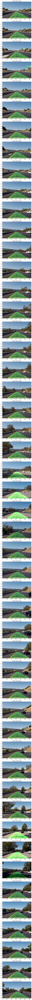

In [24]:
#
#  Frame overalying study
#


left_lane = Line()
right_lane = Line()

images = []
for i in range(0,len(file_list)):
    images.append(mpimg.imread(dirname+file_list[i]))

plt.figure(figsize=(30, 250))
columns = 1
height = images[0].shape[0] 
width  = images[0].shape[1] 
top_mask = height//2
bottom_mask = 50
images = np.array(images) 

for i, image in enumerate(images):
    # Original
    c1  = plt.subplot((len(images)), columns, columns*i + 1)
    c1.set_title(file_list[i])    
    #plt.imshow(image)    

    #c1  = plt.subplot((len(images)), columns, columns*i + 2)
    #c1.set_title("Processed")
    pimage, undist_image = image_thresh(image, mtx, dist)
    #plt.imshow(pimage)

    #c1  = plt.subplot((len(images)), columns, columns*i + 3)
    #c1.set_title("Lane")
    warped_pimage, pM, pMinv = unwarp(pimage, src, dst)
    left_lane, right_lane = findlanelines(warped_pimage)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_lane.recent_xfitted, left_lane.ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_lane.recent_xfitted, right_lane.ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    r = np.mean(undist_image[500:600, 600:800,0])+80
    g = np.mean(undist_image[500:600, 600:800,1])+80
    b = np.mean(undist_image[500:600, 600:800,2])+80

    # Counting the perceptive luminance - human eye favors green color... 
    a = ( 0.299 * r + 0.587 * g + 0.114 *b)/255;

    d = 0
    x = 0.7*np.sin(2.3*(a-3.92))+1.2 # function created to dynamically change the transaprency rate

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    font = cv2.FONT_HERSHEY_COMPLEX_SMALL 
    cv2.putText(color_warp,'off %2.1f' % right_lane.line_base_pos +' m',(430,610), font, 3,(d,d,d),4)
    radius = (right_lane.radius_of_curvature + left_lane.radius_of_curvature)/2
    cv2.putText(color_warp,'rad %3.2f' % radius +' m',(400,670), font, 3,(d,d,d),4)
    newwarp = cv2.warpPerspective(color_warp, pMinv, (warped_pimage.shape[1], warped_pimage.shape[0])) 

    result = cv2.addWeighted(undist_image, 1, newwarp,x-0.2, 0)
    plt.imshow(result)
    

In [25]:
# Import everything needed to edit/save/watch video clips
from moviepy.editor import VideoFileClip
from IPython.display import HTML

left_lane = Line()
right_lane = Line()


In [26]:
# wrap all the entire image processing into one single function call 
# it uses global varables to pass parameters ... 
def process_image(image):
    pimage, undist_image = image_thresh(image, mtx, dist)
    warped_pimage, pM, pMinv = unwarp(pimage, src, dst)
    left_lane, right_lane = findlanelines(warped_pimage)
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(binary_warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_lane.recent_xfitted, left_lane.ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_lane.recent_xfitted, right_lane.ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    r = np.mean(undist_image[500:600, 600:800,0])+80
    g = np.mean(undist_image[500:600, 600:800,1])+80
    b = np.mean(undist_image[500:600, 600:800,2])+80

    # Counting the perceptive luminance - human eye favors green color... 
    a = ( 0.299 * r + 0.587 * g + 0.114 *b)/255;

    d = 0
    x = 0.7*np.sin(2.3*(a-3.92))+1.2

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    font = cv2.FONT_HERSHEY_COMPLEX_SMALL #right_lane.line_base_pos   
    cv2.putText(color_warp,'off %2.1f' % right_lane.line_base_pos +' m',(430,610), font, 3,(d,d,d),4)
    radius = (right_lane.radius_of_curvature + left_lane.radius_of_curvature)/2
    cv2.putText(color_warp,'rad %3.2f' % radius +' m',(400,670), font, 3,(d,d,d),4)
    newwarp = cv2.warpPerspective(color_warp, pMinv, (warped_pimage.shape[1], warped_pimage.shape[0])) 

    result = cv2.addWeighted(undist_image, 1, newwarp,x-0.2, 0)

    return result


In [27]:
white_output = 'projectVideoOut.mp4'
clip1 = VideoFileClip(dirname5 + "project_video.mp4")
white_clip = clip1.fl_image(process_image) 
%time white_clip.write_videofile(white_output, audio=False)

[MoviePy] >>>> Building video projectVideoOut.mp4
[MoviePy] Writing video projectVideoOut.mp4


100%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 1260/1261 [10:33<00:00,  1.87it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: projectVideoOut.mp4 

Wall time: 10min 35s


In [28]:
HTML("""
<video width="1280" height="720" controls>
  <source src="{0}">
</video>
""".format(white_output))